## The Notebook is an Offline Exporation Asset for offline pipeline.

### It's meant to form intial hypothesis and intuition to build a binary classifier on the german credit risk dataset.

In [ ]:
!pip install pandas_profiling
!pip install plotly plotlyexpress seaborn

## Requisite Imports 

In [24]:
import os, types
import pandas as pd
from botocore.client import Config
import ibm_boto3
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from pandas_profiling import ProfileReport

from sklearn.ensemble import GradientBoostingClassifier,RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.decomposition import TruncatedSVD
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split,cross_val_score,KFold
from sklearn.metrics import roc_auc_score,confusion_matrix,plot_confusion_matrix,plot_roc_curve,f1_score,auc,roc_curve

## Load the Data 

In [25]:
# The code was removed by Watson Studio for sharing.

,CheckingStatus,LoanDuration,CreditHistory,LoanPurpose,LoanAmount,ExistingSavings,EmploymentDuration,InstallmentPercent,Sex,OthersOnLoan,...,OwnsProperty,Age,InstallmentPlans,Housing,ExistingCreditsCount,Job,Dependents,Telephone,ForeignWorker,Risk
0,0_to_200,31,credits_paid_to_date,other,1889,100_to_500,less_1,3,female,none,...,savings_insurance,32,none,own,1,skilled,1,none,yes,No Risk
1,less_0,18,credits_paid_to_date,car_new,462,less_100,1_to_4,2,female,none,...,savings_insurance,37,stores,own,2,skilled,1,none,yes,No Risk
2,less_0,15,prior_payments_delayed,furniture,250,less_100,1_to_4,2,male,none,...,real_estate,28,none,own,2,skilled,1,yes,no,No Risk
3,0_to_200,28,credits_paid_to_date,retraining,3693,less_100,greater_7,3,male,none,...,savings_insurance,32,none,own,1,skilled,1,none,yes,No Risk
4,no_checking,28,prior_payments_delayed,education,6235,500_to_1000,greater_7,3,male,none,...,unknown,57,none,own,2,skilled,1,none,yes,Risk


In [26]:
gcr_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   CheckingStatus            5000 non-null   object
 1   LoanDuration              5000 non-null   int64 
 2   CreditHistory             5000 non-null   object
 3   LoanPurpose               5000 non-null   object
 4   LoanAmount                5000 non-null   int64 
 5   ExistingSavings           5000 non-null   object
 6   EmploymentDuration        5000 non-null   object
 7   InstallmentPercent        5000 non-null   int64 
 8   Sex                       5000 non-null   object
 9   OthersOnLoan              5000 non-null   object
 10  CurrentResidenceDuration  5000 non-null   int64 
 11  OwnsProperty              5000 non-null   object
 12  Age                       5000 non-null   int64 
 13  InstallmentPlans          5000 non-null   object
 14  Housing                 

### As you can see, the data contains twenty one fields. Risk field is the one you would like to predict using feedback data.

In [27]:
print('Number of records: ', gcr_df.Risk.count())

Number of records:  5000


In [28]:
target_count = gcr_df.groupby('Risk')['Risk'].count()
target_count

Risk
No Risk    3330
Risk       1670
Name: Risk, dtype: int64

## Analyse the Data 

### Gather some stats

In [29]:
gcr_df.describe()

,LoanDuration,LoanAmount,InstallmentPercent,CurrentResidenceDuration,Age,ExistingCreditsCount,Dependents
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,21.393000,3480.145000,2.982400,2.854200,35.932400,1.465800,1.164600
std,11.162843,2488.232783,1.127096,1.115702,10.648536,0.565415,0.370856
min,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,1.000000
25%,13.000000,1326.750000,2.000000,2.000000,28.000000,1.000000,1.000000
50%,21.000000,3238.500000,3.000000,3.000000,36.000000,1.000000,1.000000
75%,29.000000,5355.000000,4.000000,4.000000,44.000000,2.000000,1.000000
max,64.000000,11676.000000,6.000000,6.000000,74.000000,4.000000,2.000000


### Check for null values

In [30]:
gcr_df.isna().sum()

CheckingStatus              0
LoanDuration                0
CreditHistory               0
LoanPurpose                 0
LoanAmount                  0
ExistingSavings             0
EmploymentDuration          0
InstallmentPercent          0
Sex                         0
OthersOnLoan                0
CurrentResidenceDuration    0
OwnsProperty                0
Age                         0
InstallmentPlans            0
Housing                     0
ExistingCreditsCount        0
Job                         0
Dependents                  0
Telephone                   0
ForeignWorker               0
Risk                        0
dtype: int64

## Sex vs Age analysis 

In [31]:
SA = gcr_df.loc[:,['Sex','Age']]
fig = px.box(SA, x="Sex", y="Age", points="all",color="Sex",width=1200)
fig.update_layout(
    title={
          'text':"Sex Vs Age Cross tabulation",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="Sex",
    yaxis_title="Age",
   
)
fig.show()

## Gender distribution

In [32]:
SA = gcr_df.loc[:,['Sex']]
fig = px.histogram(SA, x="Sex",height=400,width=800)
fig.update_layout(
    title={
          'text':"Gender Distribution",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="Sex",
    yaxis_title="Age",
   
)
fig.show()

## Dependents vs Risk

In [33]:
SA = gcr_df.loc[:,['Dependents','Risk']]
fig = px.box(SA, x="Dependents", y="Risk", points="all",color="Risk",width=900)
fig.update_layout(
    title={
          'text':"Dependents Vs Risk Cross tabulation",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="Dependents",
    yaxis_title="Risk",
   
)
fig.show()

In [34]:
SA = gcr_df.loc[:,['ExistingCreditsCount','Risk']]
fig = px.box(SA, x="ExistingCreditsCount", y="Risk", points="all",color="Risk",width=900)
fig.update_layout(
    title={
          'text':"ExistingCreditsCount Vs Risk Cross tabulation",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="ExistingCreditsCount",
    yaxis_title="Risk",
   
)
fig.show()

## Loan Purpose Analysis

In [35]:
Purpose = gcr_df['LoanPurpose']
fig = px.histogram(gcr_df, x="LoanPurpose", color="LoanPurpose")
fig.update_layout(
    title={
          'text':"LoanPurpose Analysis",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
   
)
fig.show()

## LoanPurpose Vs LoanAmount Cross tabulation Visualisation

In [36]:
SC =gcr_df.loc[:,['LoanPurpose','LoanAmount']]
fig = px.box(SC, x="LoanPurpose", y="LoanAmount", color="LoanPurpose")
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.update_layout(
    title={
          'text':"LoanPurpose Vs LoanAmount Cross tabulation",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="LoanPurpose",
    yaxis_title="LoanAmount",
   
)
fig.show()

## Distribution by Job and gender

In [37]:
fig = px.histogram(gcr_df, x="Age", y="Job", color="Sex", marginal="rug",
                   hover_data=gcr_df.columns)
fig.show()

## PropertyOwnership vs Risk


In [38]:
fig = px.histogram(gcr_df, x="OwnsProperty" ,color="Risk", marginal="rug",
                   hover_data=gcr_df.columns, width=900, height=400)
fig.update_layout(
    title={
          'text':"PropertyOwnership vs Risk",
        'y':.95,
        'x':.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title="PropertyOwnershipType",
    yaxis_title="No of Occurences")
    
fig.show()

## Age Distribution

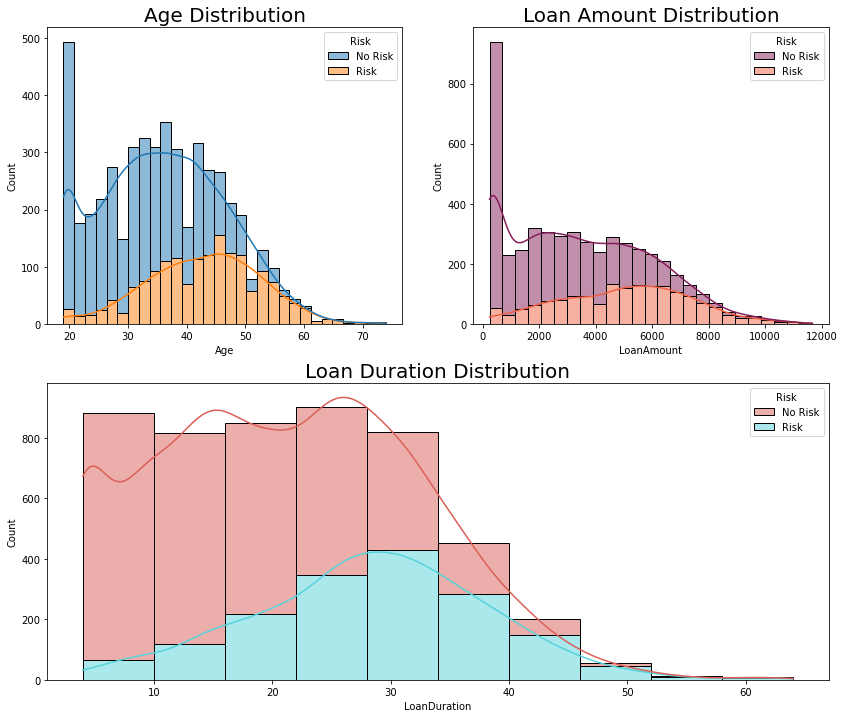

In [39]:
plt.figure(figsize=(14, 12))

plt.subplot(221)
ax1 = sns.histplot(data=gcr_df, x='Age', hue='Risk', multiple='stack', palette='tab10', kde=True)
ax1.set_title("Age Distribution", fontsize=20)

plt.subplot(222)
ax2 = sns.histplot(data=gcr_df, x='LoanAmount', hue='Risk', multiple='stack', palette='rocket', kde=True)
ax2.set_title("Loan Amount Distribution", fontsize=20)

plt.subplot(212)
ax3 = sns.histplot(data=gcr_df, x='LoanDuration', hue='Risk', multiple='stack', palette='hls', kde=True, bins=10)
ax3.set_title("Loan Duration Distribution", fontsize=20)

plt.show()

## Distribution by Gender

Text(0.5, 0, '')

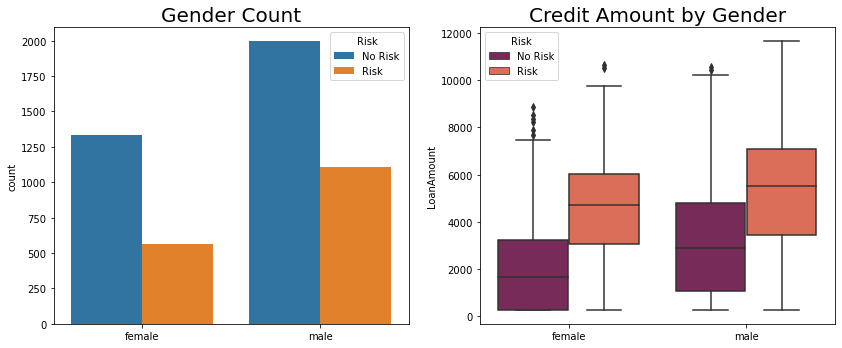

In [40]:
plt.figure(figsize=(14, 12))
plt.subplot(221)
ax1 = sns.countplot(data=gcr_df, x='Sex', hue='Risk', palette='tab10')
ax1.set_title("Gender Count", fontsize=20)
ax1.set_xlabel("")

plt.subplot(222)
ax2 = sns.boxplot(data=gcr_df, x='Sex', y='LoanAmount', palette='rocket', hue='Risk')
ax2.set_title("Credit Amount by Gender", fontsize=20)
ax2.set_xlabel("")


## Distribution by Job Category

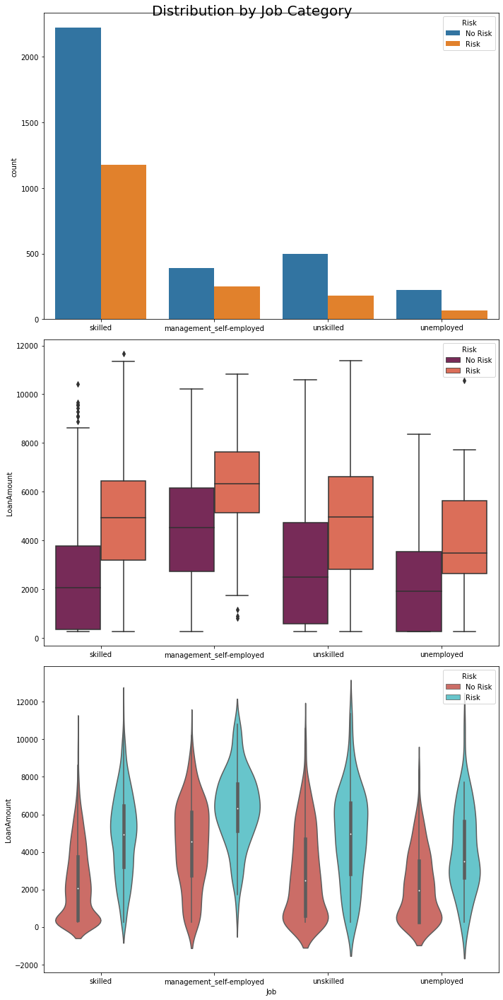

In [41]:
job_category = list(gcr_df['Job'].unique()) # createing categorial values
gcr_df['Job'] = gcr_df['Job'].replace([0, 1, 2, 3], job_category) # replacing numerical with categorical values

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 20))
fig.suptitle("Distribution by Job Category", fontsize=20)
sns.countplot(data=gcr_df, x='Job', hue='Risk', palette='tab10', ax=ax1)
ax1.set_xlabel("")

sns.boxplot(data=gcr_df, x='Job', y='LoanAmount', palette='rocket', hue='Risk', ax=ax2)
ax2.set_xlabel("")

sns.violinplot(data=gcr_df, x='Job', y='LoanAmount', palette='hls', hue='Risk', ax=ax3)
fig.tight_layout()
plt.show()

## Distribution by Duration

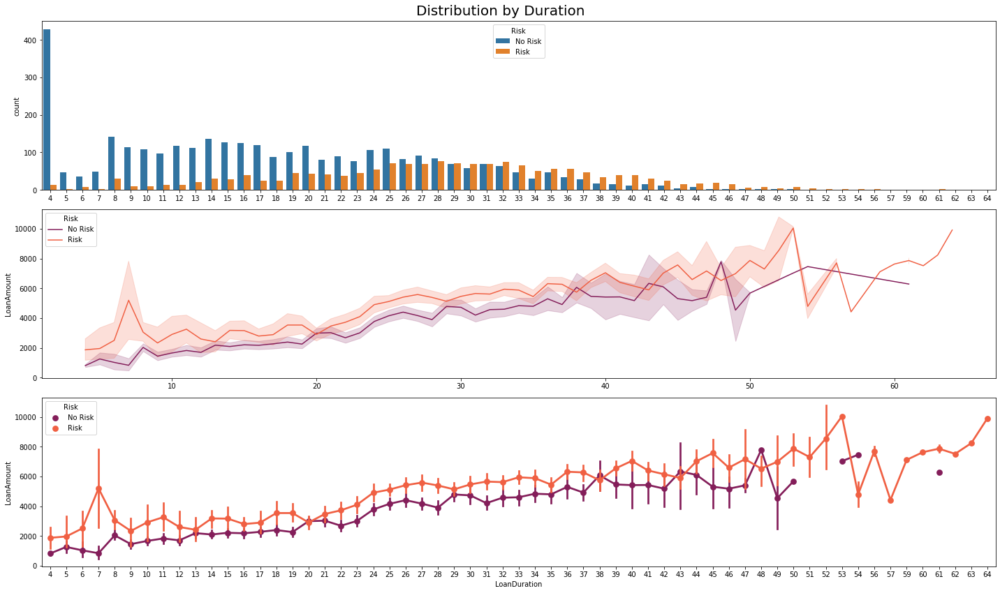

In [42]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 12))
fig.suptitle("Distribution by Duration", fontsize=20)
sns.countplot(data=gcr_df, x='LoanDuration', hue='Risk', palette='tab10', ax=ax1)
ax1.set_xlabel("")

sns.lineplot(data=gcr_df, x='LoanDuration', y='LoanAmount', hue='Risk', palette='rocket', ax=ax2)
ax2.set_xlabel("")

sns.pointplot(data=gcr_df, x='LoanDuration', y='LoanAmount', hue='Risk', palette='rocket', ax=ax3)
fig.tight_layout()
plt.show()

## Pairplots

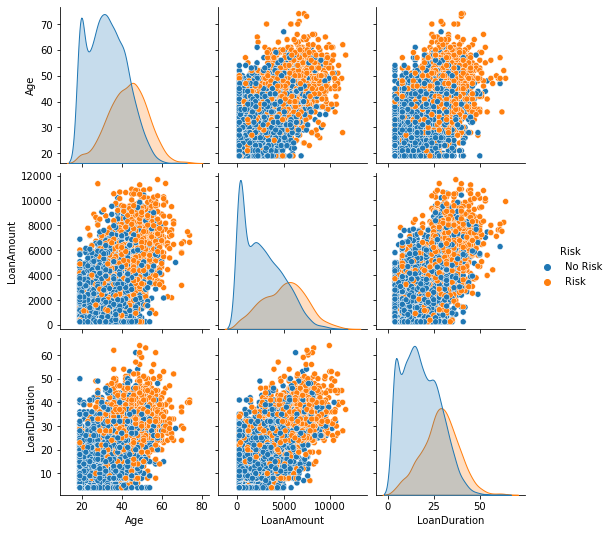

In [43]:
num_cat_risk = ['Age', 'LoanAmount', 'LoanDuration', 'Risk']
sns.pairplot(gcr_df[num_cat_risk], hue="Risk")
plt.show()

## Snapshot report

In [44]:

profile = ProfileReport(gcr_df, title="GCR Profiling Report")

In [45]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Modelling Based on the observed patterns

## Pipeline Building and Transformation

In [46]:
features_idx = np.s_[0:-1]
all_records_idx = np.s_[:]
first_record_idx = np.s_[0]

In [47]:
gcr_df['Risk'] = gcr_df['Risk'].map({'Risk':1, 'No Risk':0})

## Split the data into Train and Test Splits

In [48]:
y = gcr_df['Risk']
X=  gcr_df.drop('Risk',axis=1)

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,stratify=y)

X_train.head()

,CheckingStatus,LoanDuration,CreditHistory,LoanPurpose,LoanAmount,ExistingSavings,EmploymentDuration,InstallmentPercent,Sex,OthersOnLoan,CurrentResidenceDuration,OwnsProperty,Age,InstallmentPlans,Housing,ExistingCreditsCount,Job,Dependents,Telephone,ForeignWorker
4588,no_checking,32,outstanding_credit,repairs,6172,500_to_1000,greater_7,5,male,co-applicant,3,unknown,31,none,free,1,management_self-employed,1,yes,yes
151,0_to_200,22,credits_paid_to_date,radio_tv,2783,less_100,less_1,3,male,none,2,savings_insurance,28,none,own,1,skilled,1,none,yes
46,0_to_200,19,credits_paid_to_date,car_used,1897,100_to_500,unemployed,1,male,none,3,savings_insurance,19,none,rent,1,skilled,1,none,yes
4640,0_to_200,10,prior_payments_delayed,furniture,1961,greater_1000,1_to_4,2,female,none,1,real_estate,29,bank,rent,1,unemployed,1,none,yes
3181,no_checking,26,outstanding_credit,furniture,5978,unknown,4_to_7,4,female,none,5,car_other,48,none,own,2,management_self-employed,2,yes,yes


##  Handle Columns as per Dtypes
##  Build the Sklearn Pipeline

In [49]:
string_fields = [type(fld) is str for fld in X_train.iloc[first_record_idx, features_idx]]

In [50]:
ct = ColumnTransformer([("ohe", OneHotEncoder(), list(np.array(X_train.columns)[features_idx][string_fields]))])

In [51]:
clf = GradientBoostingClassifier(random_state=42)

In [52]:
pipeline_linear = Pipeline([('ct', ct), ('clf', clf)])

## Train a Model

In [53]:
risk_model = pipeline_linear.fit(X_train,y_train)

## Model Evaluation

In [54]:
predictions = risk_model.predict(X_test)

print(roc_auc_score(y_test,predictions))

0.7296533060006114


###  Cross Validated Score

In [55]:
cv = KFold(n_splits=5, shuffle=True, random_state=1)
scores = np.mean(cross_val_score(risk_model,X,y, cv=cv, n_jobs=-1,scoring='roc_auc'))
print(f"The Cross Validated AUC_ROC Score is {scores}")

The Cross Validated AUC_ROC Score is 0.8474333119998217


###  Confusion Matrix

<AxesSubplot:>

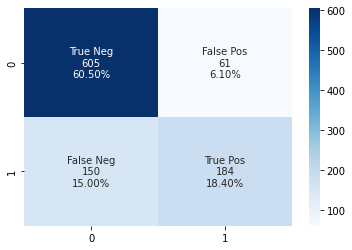

In [56]:
df_cm = confusion_matrix(y_test,predictions)

group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ["{0:0.0f}".format(value) for value in df_cm.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in df_cm.flatten()/np.sum(df_cm)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2,v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(df_cm, annot=labels, fmt='', cmap='Blues')

## ROC Curve



Area Under Curve: 0.73




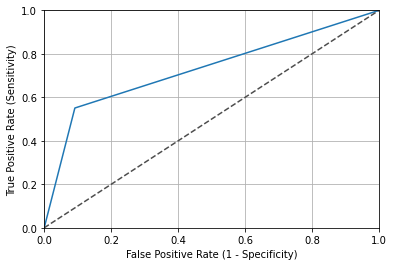

In [57]:
fpr, tpr, thresholds = roc_curve(y_test, predictions)

fig, ax = plt.subplots()
ax.plot(fpr, tpr)
ax.plot([0, 1], [0, 1], transform=ax.transAxes, ls="--", c=".3")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.rcParams['font.size'] = 12

plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.grid(True)

print("\n")
print ("Area Under Curve: %.2f" %auc(fpr, tpr))
print("\n")

## Publish the Model

In [ ]:
CLOUD_API_KEY = ""
IAM_URL="https://iam.ng.bluemix.net/oidc/token"


In [ ]:
WML_CREDENTIALS = {
                   "url": "https://us-south.ml.cloud.ibm.com",
                   "apikey": CLOUD_API_KEY
            }

In [ ]:
import json
from ibm_watson_machine_learning import APIClient

wml_client = APIClient(WML_CREDENTIALS)
wml_client.version

## List the spaces

In [ ]:
wml_client.spaces.list(limit=10)

In [ ]:
def guid_from_space_name(space_name,wml_client):
    """
    Gets the Space_ID using the Name

    """
    instance_details = wml_client.service_instance.get_details()
    space = wml_client.spaces.get_details()
    return(next(item for item in space['resources'] if item['entity']["name"] == space_name)['metadata']['id'])

In [ ]:
space_id = "e5a432ef-95aa-426a-84ac-92e083e76dd1"

In [ ]:
WML_SPACE_ID=space_id
wml_client.set.default_space(WML_SPACE_ID)

## Remove Existing instance of the model

In [ ]:
deployments_list = wml_client.deployments.get_details()
for deployment in deployments_list["resources"]:
    model_id = deployment["entity"]["asset"]["id"]
    deployment_id = deployment["metadata"]["id"]
    if deployment["metadata"]["name"] == DEPLOYMENT_NAME:
        print("Deleting deployment id", deployment_id)
        wml_client.deployments.delete(deployment_id)
        print("Deleting model id", model_id)
        wml_client.repository.delete(model_id)
wml_client.repository.list_models()

## Store the Model

In [ ]:
MODEL_NAME = "GCR_Model"

In [ ]:
#Note if there is specification related exception or specification ID is None then use "default_py3.8" instead of "default_py3.7_opence"
software_spec_uid = wml_client.software_specifications.get_id_by_name("runtime-22.1-py3.9")
print("Software Specification ID: {}".format(software_spec_uid))

model_props = {
        wml_client._models.ConfigurationMetaNames.NAME:"{}".format(MODEL_NAME),
        wml_client._models.ConfigurationMetaNames.TYPE: "scikit-learn_1.0",
        wml_client._models.ConfigurationMetaNames.SOFTWARE_SPEC_UID: software_spec_uid,
        #wml_client._models.ConfigurationMetaNames.TRAINING_DATA_REFERENCES: training_data_references,
        wml_client._models.ConfigurationMetaNames.LABEL_FIELD: "Risk",
    }

## In Project

In [ ]:
import os
project_id = os.environ['PROJECT_ID']
wml_client.set.default_project(project_id)

In [ ]:
print("Storing model ...")

published_model_details = wml_client.repository.store_model(model=risk_model, meta_props=model_props, training_data=gcr_df.drop(["Risk"], axis=1), training_target=gcr_df.Risk)
model_uid = wml_client.repository.get_model_id(published_model_details)
print("Done")
print("Model ID: {}".format(model_uid))

## In the deployment space

In [ ]:
wml_client.set.default_space(space_id)

In [ ]:
print("Storing model ...")

published_model_details = wml_client.repository.store_model(model=risk_model, meta_props=model_props, training_data=gcr_df.drop(["Risk"], axis=1), training_target=gcr_df.Risk)
model_uid = wml_client.repository.get_model_id(published_model_details)
print("Done")
print("Model ID: {}".format(model_uid))

## Deploy the Model

In [ ]:
print("Deploying model...")
deployment_details = wml_client.deployments.create(
    model_uid, 
    meta_props={
        wml_client.deployments.ConfigurationMetaNames.NAME: "{}".format(f'{MODEL_NAME}_ONLINE'),
        wml_client.deployments.ConfigurationMetaNames.ONLINE: {}
    }
)
scoring_url = wml_client.deployments.get_scoring_href(deployment_details)
deployment_uid=wml_client.deployments.get_uid(deployment_details)

print("Scoring URL:" + scoring_url)
print("Model id: {}".format(model_uid))
print("Deployment id: {}".format(deployment_uid))

## Score the Model

In [ ]:
fields = ["CheckingStatus", "LoanDuration", "CreditHistory", "LoanPurpose", "LoanAmount", "ExistingSavings",
                  "EmploymentDuration", "InstallmentPercent", "Sex", "OthersOnLoan", "CurrentResidenceDuration",
                  "OwnsProperty", "Age", "InstallmentPlans", "Housing", "ExistingCreditsCount", "Job", "Dependents",
                  "Telephone", "ForeignWorker"]
values = [
            ["no_checking", 13, "credits_paid_to_date", "car_new", 1343, "100_to_500", "1_to_4", 2, "female", "none", 3,
             "savings_insurance", 46, "none", "own", 2, "skilled", 1, "none", "yes"],
            ["no_checking", 24, "prior_payments_delayed", "furniture", 4567, "500_to_1000", "1_to_4", 4, "male", "none",
             4, "savings_insurance", 36, "none", "free", 2, "management_self-employed", 1, "none", "yes"],
        ]

scoring_payload = {"input_data": [{"fields": fields, "values": values}]}

In [ ]:
predictions = wml_client.deployments.score(deployment_uid, scoring_payload)
predictions